In [1]:

import warnings
warnings.filterwarnings("ignore", message="numpy.dtype size changed")
warnings.filterwarnings("ignore", message="numpy.ufunc size changed")
warnings.filterwarnings("ignore", message="the matrix subclass is")
warnings.filterwarnings(action="ignore", module="scipy", message="^internal gelsd")
import tensorflow as tf

/usr/local/lib/python3.5/site-packages/h5py/__init__.py:36: FutureWarning: Conversion of the second argument of issubdtype from `float` to `np.floating` is deprecated. In future, it will be treated as `np.float64 == np.dtype(float).type`.
  from ._conv import register_converters as _register_converters


In [2]:
import math
import numpy as np
np.set_printoptions(precision=3)
from scipy.spatial.distance import pdist, squareform
from sklearn.linear_model import LinearRegression
from sklearn.model_selection import train_test_split

import os
import sys
sys.path.append("../")
sys.path.append("../baselines/")

from baselines import baselines
from distance_matching_lowrank import DistanceMatching
import time
import functions
from utils import *
import matplotlib.pyplot as plt

In [3]:
# overriding the utils.py def
def plot_learned_betas(true_beta,
    estimations, zero_line_xs, zero_line_ys, plot_zeros=False):
    fig = plt.figure()
    
    # Assumes the first value in each row of U is a category
    colors = ['green', 'orange', 'purple', 'red', 'yellow']
    true_color  = 'black'
    true_marker = '+'
    markers = ['+', 'o', '.', 'x', 'v']

    handles = []
    descriptions = []
    for j, (estimation, estimator_name) in enumerate(estimations):
        fig = plt.figure()
        idxs = np.linspace(0, len(true_beta)-1, 100, dtype=int)
        handle = plt.scatter(true_beta[idxs, 0], true_beta[idxs, 1], color=true_color, marker=true_marker, alpha=0.5)
        handle = plt.scatter(
            estimation[idxs, 0],
            estimation[idxs, 1],
            color='red', marker='x', label=estimator_name, alpha=0.5)
        plt.xticks(fontsize=18)
        plt.yticks(fontsize=18)
        plt.tight_layout()
        plt.savefig("Synthetic/simple_experiment_results_{}.pdf".format(estimator_name))
    plt.show()

In [4]:
def generate_data():
    sigma_eps = 1e-3
    N = 2500
    P = 2
    K = 1

    z = [np.random.uniform(0, 1) for i in range(N)]
    X = np.random.uniform(-1, 1, size=(N, P))
    plt.scatter(X[:, 0], X[:, 1])
    plt.show()
    U = np.array([
        np.array([z[i]]) for i in range(N)])
    dU = [lambda x,y: np.logical_xor(np.abs(x) > 0.5, np.abs(y) > 0.5)]
    dU = [lambda x,y: np.abs(x-y)]

    a = (np.abs(U[:, 0] - 0.5) > 0.25) + 0.1*np.sin(U[:, 0]*3*np.pi)
    true_beta = np.hstack((
        np.expand_dims(U[:, 0].copy(), 1),
        np.expand_dims(a, 1)))

    fig = plt.figure()
    plt.scatter(true_beta[:, 0], true_beta[:, 1])
    plt.show()
    
    # Generate Y
    Y = np.array([X[i].dot(true_beta[i]) for i in range(N)])
    epsilons = np.random.normal(0, sigma_eps, size=(N))
    Y += epsilons

    zero_line_xs = [
        np.linspace(true_beta[i,0]-min(0.5, 0.5/np.abs(X[i, 0]/X[i, 1])),
            true_beta[i,0]+min(0.5, 0.5/np.abs(X[i, 0]/X[i, 1])), 1000) for i in range(N)
    ]
    zero_line_ys = [
        [(Y[i] - X[i, 0]*x)/X[i, 1] for x in zero_line_xs[i]] for i in range(N)
    ]

    n_classes = 2
    Y = np.expand_dims(Y, 1)

    return N, P, K, true_beta, X, U, Y, dU, zero_line_xs, zero_line_ys, n_classes

In [5]:
def fit_baselines(X, U, Y, n_classes, lam=1e-4):
    # Baselines
    print("="*5 + "Fitting Baselines" + "="*5)
    all_zeros = np.zeros_like(X)
    n_mixtures = 3
    init_mixture_beta = np.random.uniform(0, 1, size=(2, n_mixtures))
    # Help out mixture baseline by starting with (0, 1), (0.5, 0), (1, 1)
    init_mixture_beta[:, 0] = [0, 1.25]
    init_mixture_beta[:, 1] = [0.5, -0.25]
    init_mixture_beta[:, 2] = [1, 1.25]
    mixture_beta, mixture_assignments = baselines.mixture_model_linear(
        X, Y, n_mixtures, 0., max_iters=2000, init_beta=init_mixture_beta,
        n_restarts=3, init_lr=1e-3, fit_intercept=False, verbose=False)
    plt.scatter(mixture_beta[:, 0], mixture_beta[:, 1])
    plt.show()
    pop_beta = baselines.linear_lasso(X, Y, lam)
    vc_beta, vc_Z = baselines.vc_linear(X, Y, U, lam, lr=1e-4)
    print("="*5 + "Finished Fitting Baselines" + "="*5)
    return all_zeros, pop_beta, mixture_beta, mixture_assignments, vc_beta

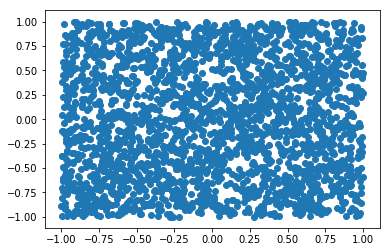

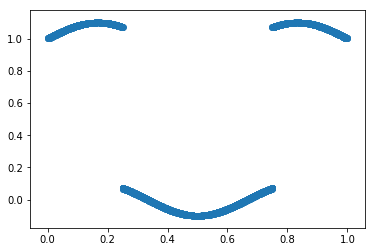

In [6]:
N, P, K, true_beta, X, U, Y, dU, zero_line_xs, zero_line_ys, n_classes = generate_data()

X_train, X_test, Y_train, Y_test, U_train, U_test, true_beta_train, true_beta_test = train_test_split(X, Y, U, true_beta, test_size=0.2)
N_train = len(X_train)
N_test = len(X_test)

In [7]:
# Deep Learning benchmark.
batch_size = 25
warnings.simplefilter("ignore", DeprecationWarning)

# Define a model with many linear regression atoms.
def xavier_init(fan_in, fan_out, constant=1):
    #Xavier initialization of network weights
    low = -constant*np.sqrt(6.0/(fan_in + fan_out))
    high = constant*np.sqrt(6.0/(fan_in + fan_out + 1))
    return tf.random_uniform((fan_in, fan_out),
                             minval=low, maxval=high,
                             dtype=tf.float32)

lr = 1e-3
lr_decay = 1-1e-5
learning_rate = tf.Variable(lr)

X_shape = X_train.shape[1] + U_train.shape[1]
Y_shape = [1]

x = tf.placeholder(tf.float32, [None, X_shape])
y = tf.placeholder(tf.float32, [None, 1])

n_hidden = [5, 5, 5, 5]
eta_1 = tf.verify_tensor_all_finite(
    tf.Variable(tf.random_uniform(
        (X_shape, n_hidden[0]), minval=0, maxval=1, dtype=tf.float32)),
    'eta_1 not finite')
b_1   = tf.Variable(tf.zeros([n_hidden[0]], dtype=tf.float32))
eta_2 = tf.verify_tensor_all_finite(
    tf.Variable(tf.random_uniform(
        (n_hidden[0], n_hidden[1]), minval=0, maxval=1, dtype=tf.float32)),
    'eta_2 not finite')
b_2   = tf.Variable(tf.zeros([n_hidden[1]], dtype=tf.float32))
eta_3 = tf.verify_tensor_all_finite(
    tf.Variable(tf.random_uniform(
        (n_hidden[1], n_hidden[2]), minval=0, maxval=1, dtype=tf.float32)),
    'eta_3 not finite')
b_3   = tf.Variable(tf.zeros(n_hidden[2], dtype=tf.float32))
eta_4 = tf.verify_tensor_all_finite(
    tf.Variable(tf.random_uniform(
        (n_hidden[2], n_hidden[3]), minval=0, maxval=1, dtype=tf.float32)),
    'eta_4 not finite')
b_4   = tf.Variable(tf.zeros(n_hidden[3], dtype=tf.float32))
eta_5 = tf.verify_tensor_all_finite(
    tf.Variable(tf.random_uniform(
        (n_hidden[3], Y_shape[0]), minval=0, maxval=1, dtype=tf.float32)),
    'eta_5 not finite')
b_5   = tf.Variable(tf.zeros(Y_shape, dtype=tf.float32))


hidden_1 = tf.nn.sigmoid(tf.add(tf.matmul(x, eta_1), b_1))
hidden_2 = tf.nn.sigmoid(tf.add(tf.matmul(hidden_1, eta_2), b_2))
hidden_3 = tf.nn.sigmoid(tf.add(tf.matmul(hidden_2, eta_3), b_3))
hidden_4 = tf.nn.sigmoid(tf.add(tf.matmul(hidden_3, eta_4), b_4))
y_hat  = tf.add(tf.matmul(hidden_4, eta_5), b_5)

pred_loss = tf.losses.mean_squared_error(y, y_hat)
l2_loss = tf.add_n([ tf.nn.l2_loss(v) for v in [eta_1, eta_2, eta_3, eta_4] ])*0.00
loss = pred_loss + l2_loss

optimizer = tf.train.AdamOptimizer(learning_rate=learning_rate).minimize(loss)
init = tf.global_variables_initializer()
sess = tf.InteractiveSession()
sess.run(init)

In [8]:
XU_train = np.hstack((X_train, U_train))

In [9]:
n_epochs = 1000
for i in range(n_epochs):
    learning_rate *= lr_decay
    permutation = np.random.permutation(len(X_train))
    total_cost = 0
    total_pred_cost = 0
    total_l2_cost = 0
    for idx in range(0, len(X_train)-batch_size, batch_size):
        start = idx
        end = idx + batch_size
        opt, cost, pred_cost, l2_cost, y_hat_val = sess.run((optimizer, loss, pred_loss, l2_loss, y_hat),
                                       feed_dict={
                                           x: XU_train[permutation[start:end]],
                                           y: Y_train[permutation[start:end]]
                                       })
        total_cost += cost
        total_pred_cost += pred_cost
        total_l2_cost += l2_cost
    if i % 10 == 0:
        print("{}\t{:.3f}\t{:.3f}\t{:.3f}".format(i, total_cost, total_pred_cost, total_l2_cost))

0.001
0	436.760	436.760	0.000
10	22.903	22.903	0.000
20	22.380	22.380	0.000
30	22.292	22.292	0.000
40	22.224	22.224	0.000
50	21.678	21.678	0.000
60	12.963	12.963	0.000
70	11.309	11.309	0.000
80	11.038	11.038	0.000
90	10.842	10.842	0.000
100	10.662	10.662	0.000
110	10.484	10.484	0.000
120	10.414	10.414	0.000
130	10.365	10.365	0.000
140	10.324	10.324	0.000
150	10.210	10.210	0.000
160	10.182	10.182	0.000
170	10.051	10.051	0.000
180	9.958	9.958	0.000
190	9.939	9.939	0.000
200	9.903	9.903	0.000
210	9.832	9.832	0.000
220	9.662	9.662	0.000
230	9.623	9.623	0.000
240	9.464	9.464	0.000
250	9.346	9.346	0.000
260	9.226	9.226	0.000
270	9.138	9.138	0.000
280	8.893	8.893	0.000
290	8.800	8.800	0.000
300	8.651	8.651	0.000
310	8.532	8.532	0.000
320	8.371	8.371	0.000
330	8.358	8.358	0.000
340	8.317	8.317	0.000
350	8.226	8.226	0.000
360	8.239	8.239	0.000
370	8.162	8.162	0.000
380	8.221	8.221	0.000
390	8.206	8.206	0.000
400	8.142	8.142	0.000
410	8.123	8.123	0.000
420	8.104	8.104	0.000
430	8.114	8.114	0.000

In [10]:
predictions_deep = sess.run((y_hat),
                       feed_dict={
                           x: np.hstack((X_train, U_train))
                       })

test_predictions_deep = sess.run((y_hat),
                           feed_dict={
                               x: np.hstack((X_test, U_test))
                           })

print("DL Train Prediction Error: {:.3f}".format(np.mean((np.squeeze(Y_train) - predictions_deep)**2)))
print("DL Test  Prediction Error: {:.3f}".format(np.mean((np.squeeze(Y_test) - test_predictions_deep)**2)))

dl_preds, dl_preds_test = predictions_deep, test_predictions_deep

DL Train Prediction Error: 0.545
DL Test  Prediction Error: 0.621


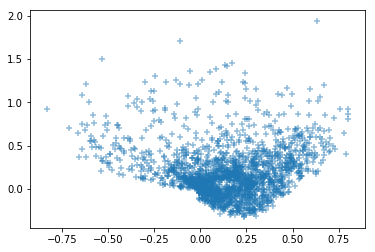

In [11]:
def quick_linear(x, y):
    return np.linalg.inv(x.T.dot(x) + 0.01*np.eye(x.shape[1])).dot(x.T.dot(y))

def fit_linear_approx(i):
    neighborhood = np.hstack((
        np.random.normal(X_train[i], 0.001, size=(25, 2)),
        np.random.normal(U_train[i], 0.001, size=(25, 1))
    ))
    neighbor_preds = sess.run((y_hat), feed_dict={
        x: neighborhood
    })
    beta_approx = quick_linear(neighborhood, neighbor_preds)
    return beta_approx

dl_betas = []
for i in range(len(X_train)):
    dl_betas.append(fit_linear_approx(i))
dl_betas = np.array(dl_betas)
fig = plt.figure()
plt.scatter(dl_betas[:, 0], dl_betas[:, 1], marker='+', alpha=0.5)
plt.show()

=====Fitting Baselines=====
Fitting Mixture Model for Linear Regression
Random restarts (3/3): [####################] 100%0 Elapsed time: 0:00:15
Took 14.96 seconds


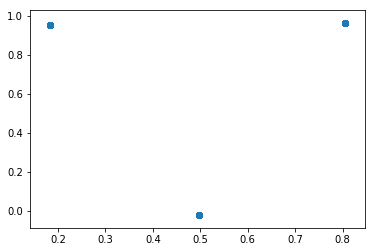

Fitting Linear Regression with Lasso Reg.
Estimate at Iteration 0
[0. 0.]
Loss at Iteration     0: 0.14151540869657808
Estimate at Iteration 100
[0.1395 0.1374]
Loss at Iteration     100: 0.10287643821875611
Estimate at Iteration 200
[0.239  0.2351]
Loss at Iteration     200: 0.083264044279355
Estimate at Iteration 300
[0.31   0.3047]
Loss at Iteration     300: 0.07330910002415786
Estimate at Iteration 400
[0.3607 0.3542]
Loss at Iteration     400: 0.0682560886553506
Estimate at Iteration 500
[0.3968 0.3894]
Loss at Iteration     500: 0.06569122080743636
Estimate at Iteration 600
[0.4226 0.4144]
Loss at Iteration     600: 0.06438930456736634
Estimate at Iteration 700
[0.441  0.4322]
Loss at Iteration     700: 0.06372845214411742
Estimate at Iteration 800
[0.4541 0.4449]
Loss at Iteration     800: 0.06339300092054542
Estimate at Iteration 900
[0.4635 0.4539]
Loss at Iteration     900: 0.06322272321658697
Fitting Varying Coefficients with Linear Output.
Restart 1 of 1
Iteration: 0 Total 

In [15]:
lam=0.
try:
    warnings.filterwarnings(action="ignore", module="scipy", message="^internal gelsd")
    all_zeros, pop_beta, mixture_beta, mixture_assignments, vc_beta = fit_baselines(
        X_train, U_train, Y_train, n_classes, lam=lam)
except RuntimeWarning:
    warnings.filterwarnings(action="ignore", module="scipy", message="^internal gelsd")
    all_zeros, pop_beta, mixture_beta, mixture_assignments, vc_beta = fit_baselines(
        X_train, U_train, Y_train, n_classes, lam=lam)

======Fitting Least Squares with Learned Metrics======
Calculating Pairwise Co-Variate Distances...
Making Co-Variate Distance Matrix of Size 2000x2000x1
Finished making unnormalized version.
Finished normalizing.
Took 74.245 seconds.
Finished. Took 74.245 seconds.
Saving Pairwise Co-Variate Distances to simple_delta_U
Fitting Least Squares with Learned Metrics
Restart 1 of 1
(2,)
[[0.9012 0.3737]
 [0.8288 0.3934]
 [0.6434 0.444 ]
 ...
 [0.5081 0.481 ]
 [0.8219 0.3953]
 [0.4281 0.5028]]
[[ 0.4084 -0.1115]
 [ 0.3359 -0.0917]
 [ 0.1505 -0.0411]
 ...
 [ 0.0152 -0.0042]
 [ 0.329  -0.0898]
 [-0.0647  0.0177]]
[1.0000e+00 2.4441e-30]
No neighborhoods supplied. Will use random neighbors.


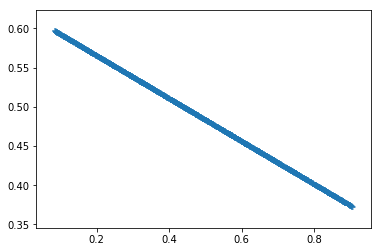

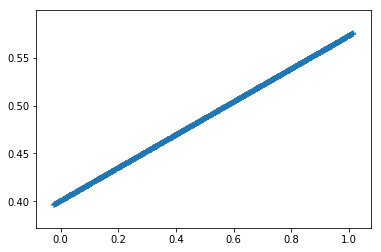

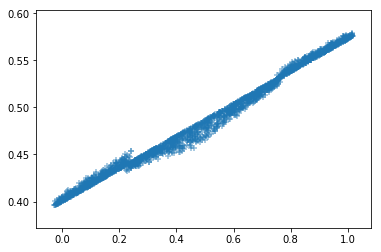

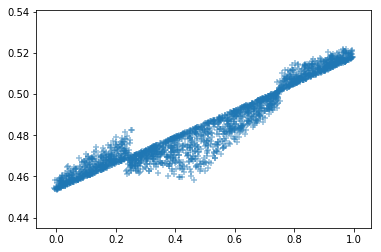

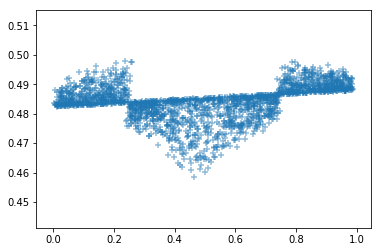

...

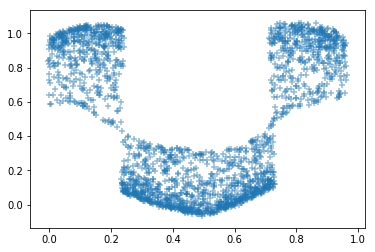

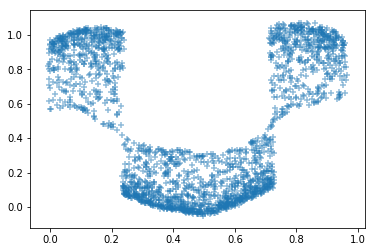

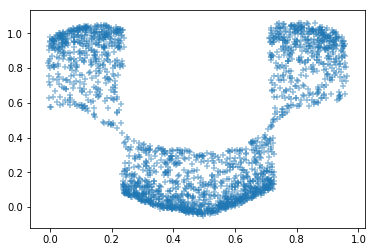

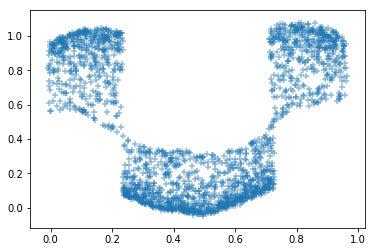

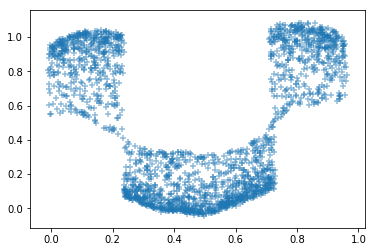

Reached local minimum at iteration 841.
Took 768.767 seconds.
** New best solution **


In [16]:
### Distance Matching
print("======Fitting Least Squares with Learned Metrics======")

# Personalization Hyper-parameters.
n_neighbors = 5
gamma = 1e6   # Pairwise Regularization Strength
upsilon = 1e-3 # Phi_U Regularization Strength

# Define regularization functions.
f       = functions.linear_loss
f_prime = functions.linear_loss_prime

# Lasso regularization on beta
beta_target = np.zeros((P))
rho_beta       = lambda beta, i: lam*functions.lasso_penalty(beta, beta_target)
rho_beta_prime = lambda beta, i: lam*functions.lasso_derivative(beta, beta_target)

# Regularization on phi_u
init_phi_u      = soft_normalize(np.ones((K)))
# Lasso penalty for sparisty in personalization.
psi_u = lambda phi_u: upsilon*np.linalg.norm(phi_u - np.zeros((K)), ord=1)
psi_u_prime = lambda phi_u: upsilon*np.sign(phi_u - np.zeros((K)))

dml = DistanceMatching(vc_beta,
    f, f_prime,
    gamma, latent_dim=2,
    n_neighbors=n_neighbors, update_ztree_every=10,
    calc_dist_errors_every=1,
    calc_closest_every=10,
    rho_beta=rho_beta, rho_beta_prime=rho_beta_prime,
    init_phi_u=init_phi_u, psi_u=psi_u, psi_u_prime=psi_u_prime,
    intercept=False, log_dir='./', n_threads=1)

delta_U_fname="simple_delta_U"
delta_U = create_delta_U(dml, U_train, dU, K, N_train, delta_U_fname, normalize=False)
print("Fitting Least Squares with Learned Metrics")

z_dmr, q_dmr = dml.fit(
    X_train, Y_train, U_train, dU, delta_U=delta_U,
    init_lr=4e-3, lr_decay=1-1e-4, n_restarts=1,
    calc_neighbors=False,
    init_patience=250, max_iters=2000, tol=1e-8,
    verbosity=1, log_file=None)

beta_hat_learned = dml.beta_hat

In [17]:
estimations = [(pop_beta, "Population Estimator")
               ,(mixture_beta, "Mixture Model")
               ,(vc_beta, "Varying Coefficient")
               ,(dl_betas, "Deep Learning-Local Linear")
               ,(beta_hat_learned, "Personalized Regression")]

if N*P < 100:
    print("="*20 + "    True Betas   " + "="*20)
    print(true_beta_train)
    print("="*20 + " Estimated Betas " + "="*20)
    for (beta_hat, name) in estimations:
        print("{}: {}".format(name, beta_hat))

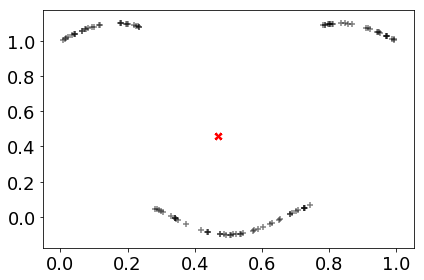

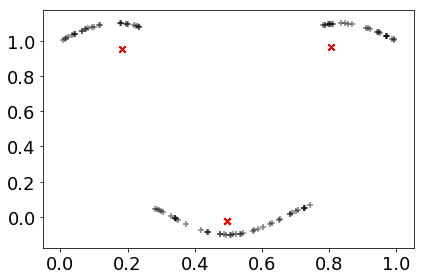

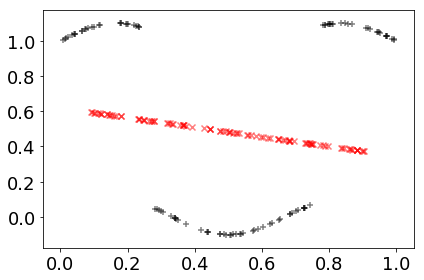

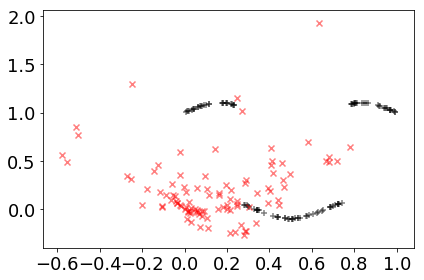

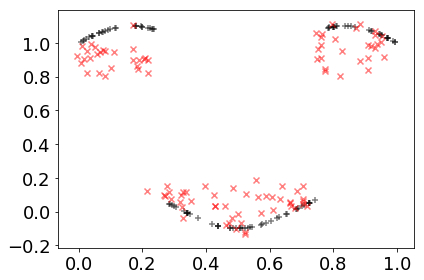

In [18]:
plot_results = True
if plot_results and P == 2:
    plot_learned_betas(true_beta_train, estimations, zero_line_xs, zero_line_ys)

In [19]:
calc_l2_err = lambda beta_hat: np.linalg.norm(true_beta_train - np.squeeze(beta_hat[:, :2]), ord=2)
l2_errs = print_errors(calc_l2_err, estimations, "     Beta L2 ")

====================      Beta L2  Error ====================
Population Estimator:24.7458
Mixture Model:20.7561
Varying Coefficient:24.8226
Deep Learning-Local Linear:29.6443
Personalized Regression:6.8614


In [20]:
test_beta_idx = [np.argsort(np.squeeze(np.abs(U_train - U_test[i])))[:3] for i in range(N_test)]

In [21]:
mse = lambda true, preds: np.mean((np.squeeze(true) - np.squeeze(preds))**2)
mse_train = lambda preds: mse(Y_train, preds)
mse_test  = lambda preds: mse(Y_test, preds)

train_preds = [(
    np.array([X_train[i].dot(estimation[0][i][:2])
    for i in range(N_train)]), estimation[1])
    for estimation in estimations
]

test_preds  = [(
    np.array([X_test[i].dot(
    np.mean(estimation[0][test_beta_idx[i]][:, :2], axis=0))
    for i in range(N_test)]), estimation[1])
    for estimation in estimations
]

train_preds.append((dl_preds, "Deep Learning"))
test_preds.append((dl_preds_test, "Deep Learning"))

train_errs = print_errors(mse_train, train_preds, " Train MSE ")
test_errs  = print_errors(mse_test,  test_preds,  " Test MSE ")

====================  Train MSE  Error ====================
Population Estimator:0.1263
Mixture Model:0.0158
Varying Coefficient:0.1041
Deep Learning-Local Linear:0.0619
Personalized Regression:0.0036
Deep Learning:0.0220
====================  Test MSE  Error ====================
Population Estimator:0.1427
Mixture Model:0.0752
Varying Coefficient:0.1144
Deep Learning-Local Linear:0.1898
Personalized Regression:0.0098
Deep Learning:0.0265


In [22]:
from sklearn.metrics import r2_score
r2_train = lambda preds: r2_score(np.squeeze(Y_train), preds)
r2_test  = lambda preds: r2_score(np.squeeze(Y_test), preds)
train_r2s = print_errors(r2_train, train_preds, " In-Sample R^2")
test_r2s  = print_errors(r2_test,  test_preds, "Out-of-Sample R^2")

====================  In-Sample R^2 Error ====================
Population Estimator:0.5538
Mixture Model:0.9443
Varying Coefficient:0.6323
Deep Learning-Local Linear:0.7813
Personalized Regression:0.9872
Deep Learning:0.9223
==================== Out-of-Sample R^2 Error ====================
Population Estimator:0.5665
Mixture Model:0.7716
Varying Coefficient:0.6527
Deep Learning-Local Linear:0.4237
Personalized Regression:0.9703
Deep Learning:0.9195
